# Discriminator

The first target is to train a discriminator that can efficiently learn to seperate random sounds from real samples.

## Imports and data loading

In [13]:
## Imports and data loading

%load_ext autoreload
%autoreload 2

import numpy as np
from matplotlib import pyplot as plt

from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.layers import TimeDistributed
from tensorflow.keras import metrics

from musicrl.midi2vec import MidiVectorMapper
from musicrl.render import *
from musicrl.random_generator import generate_random_midi, resemble_midi
from musicrl.data import RandomMidiDataGenerator

import pretty_midi
from glob import glob


REAL = 1
GEN = 0

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
filepaths = list(glob('maestro-v2.0.0/2008/**.midi'))
real_midis = [pretty_midi.PrettyMIDI(i) for i in filepaths]
mapper = MidiVectorMapper(real_midis)

## Naming convention

Let's use a naming schema that works like this:
- `rand_midi`: random sequence of type PrettyMidi
- `rand_seq`: random sequence of vectorized midi
- `rand_wav`: random sequence as synthesized waveform
- `rand_mel`: mel spectrogram of rand_wav

And for collections, we use `rand_midis`, `rand_seqs`, `rand_wavs` and `rand_mels`.

For non generated sequences, let's use `real_...`.

For predictions on `something_mel`, we use `pred_something` and for labels, we use `y_something`.

## Loading and visualizing some data

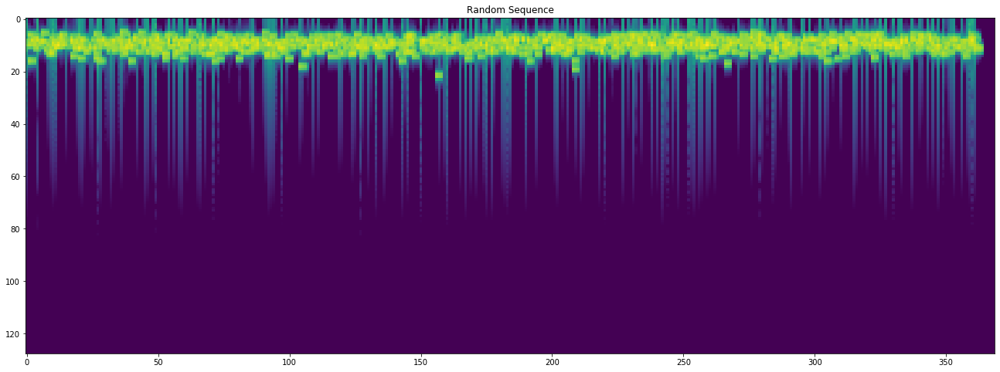

In [6]:
real_seq = mapper.midi2vec(real_midis[1])
rand_seq = generate_random_midi(real_seq, seconds=84, num_events=real_seq.shape[0])
rand_midi = mapper.vec2midi(rand_seq)
listen_to(rand_midi)
rand_mel = midi2mel(rand_midi)
plot_spectro(rand_mel, "Random Sequence")

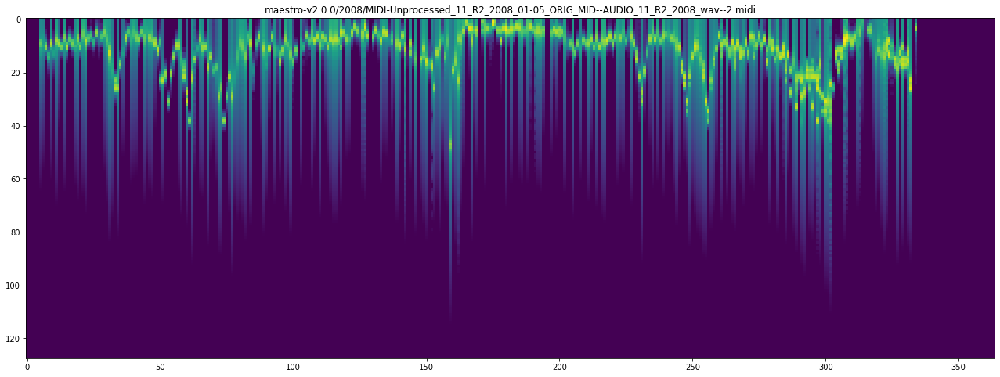

In [15]:
real_mel = midi2mel(real_midis[1])
plot_spectro(real_mel, filepaths[1])

In [13]:
listen_to(real_midis[1])

In [14]:
listen_to(mapper.vec2midi(mapper.midi2vec(real_midis[1])))

In [74]:
real_midis[0].__dict__

{'resolution': 384,
 '_tick_scales': [(0, 0.0013020833333333333)],
 '_PrettyMIDI__tick_to_time': array([0.00000000e+00, 1.30208333e-03, 2.60416667e-03, ...,
        3.67843750e+02, 3.67845052e+02, 3.67846354e+02]),
 'key_signature_changes': [],
 'time_signature_changes': [TimeSignature(numerator=4, denominator=4, time=0.0)],
 'lyrics': [],
 'instruments': [Instrument(program=0, is_drum=False, name="Levitsky04-08.MID")]}

## LSTM

We can try a number of models, e.g. a LSTM, a transformer or a CNN. Let's start with an LSTM.
The objective of this notebook is to find a trainable architecture, that learns to discriminate random songs from real ones.
We would also like to have an architecture that is trainable fast and generalizes from few samples, since the task is easy. So we will start with a training set of size 2.

### Utility functions

This stuff is already refactored

In [6]:
def mel2trainset(*mels):
    min_length = min([mel.shape[1] for mel in mels])
    return np.array([mel.T[:min_length] for mel in mels])

x_train = [midi2mel(midi) for midi in real_midis[:3]] + \
    [midi2mel(mapper.vec2midi(resemble_midi(midi, mapper))) for midi in real_midis[:3]]
x_train = mel2trainset(*x_train)
y_train = np.array([REAL, REAL, REAL, GEN, GEN, GEN]).reshape([6,1])



In [7]:
testset = []
for i in range(6,9):
    testset += [midi2mel(real_midis[i])]
    
for i in range(6,9):
    testset += [midi2mel(mapper.vec2midi(resemble_midi(real_midis[i], mapper)))]
    
x_test = mel2trainset(*testset)
y_test = np.array([REAL]*3 + [GEN]*3).reshape([-1, 1])

In [8]:
def train_generator():
    while True:
        yield x_train, y_train
        
def test_generator():
    while True:
        yield x_test, y_test

In [9]:
def plot_history(history):
    plt.figure(figsize=(12,4))
    plt.subplot(121)
    plt.title("Loss")
    plt.plot(history.history['loss'], label='Train')
    plt.plot(history.history['val_loss'], label='Test')
    plt.legend()
    plt.subplot(122)
    plt.title("Accuracy")
    plt.plot(history.history['val_binary_accuracy'], label='Train')
    plt.plot(history.history['binary_accuracy'], label='Test')
    plt.legend()
    plt.show()

In [10]:
x_test = x_test[:,:8000,:]

In [11]:
x_train.shape, x_test.shape

((6, 7268, 128), (6, 8000, 128))

### Architectures on mel

In [ ]:
model = Sequential()
model.add(LSTM(20,
          input_shape=(None, 128))) # 
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=[metrics.binary_accuracy])

history = model.fit_generator(train_generator(), validation_data=test_generator(),
                              steps_per_epoch=1, epochs=10, validation_steps=1, validation_freq=1)
plot_history(history)

Let's increase the size

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 1 steps, validate for 1 steps
Epoch 1/10
1/1 [==============================] - 8s 8s/step - loss: 0.7708 - binary_accuracy: 0.1667 - val_loss: 0.6242 - val_binary_accuracy: 0.5000
Epoch 2/10
1/1 [==============================] - 6s 6s/step - loss: 0.6497 - binary_accuracy: 0.6667 - val_loss: 0.6184 - val_binary_accuracy: 0.6667
Epoch 3/10
1/1 [==============================] - 5s 5s/step - loss: 0.5809 - binary_accuracy: 0.8333 - val_loss: 0.6187 - val_binary_accuracy: 0.6667
Epoch 4/10
1/1 [==============================] - 5s 5s/step - loss: 0.5730 - binary_accuracy: 0.8333 - val_loss: 0.5824 - val_binary_accuracy: 0.6667
Epoch 5/10
1/1 [==============================] - 5s 5s/step - loss: 0.5306 - binary_accuracy: 0.8333 - val_loss: 0.5371 - val_binary_accuracy: 0.6667
Epoch 6/10
1/1 [==============================] - 5s 5s/step - loss: 0.4898 - binary_accuracy: 0.8333 - val_loss: 0.5081 - val_binary_accuracy: 0.6667
Epoc

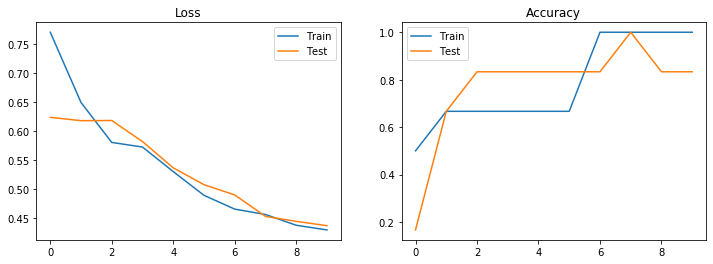

In [164]:
model = Sequential()
model.add(LSTM(128,
          input_shape=(None, 128))) # 
model.add(Dense(128, activation='tanh'))
model.add(Dense(1, activation='sigmoid'))

model.compile(loss='binary_crossentropy', optimizer='adam', metrics=[metrics.binary_accuracy])

history = model.fit_generator(train_generator(), validation_data=test_generator(),
                              steps_per_epoch=1, epochs=10, validation_steps=1, validation_freq=1)
plot_history(history)

And train with label sequences

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 1 steps, validate for 1 steps
Epoch 1/10
1/1 [==============================] - 5s 5s/step - loss: 0.6104 - binary_accuracy: 0.5000 - val_loss: 0.5926 - val_binary_accuracy: 0.8484
Epoch 2/10
1/1 [==============================] - 5s 5s/step - loss: 0.5895 - binary_accuracy: 0.9404 - val_loss: 0.5857 - val_binary_accuracy: 0.8889
Epoch 3/10
1/1 [==============================] - 5s 5s/step - loss: 0.5770 - binary_accuracy: 0.9864 - val_loss: 0.5809 - val_binary_accuracy: 0.9699
Epoch 4/10
1/1 [==============================] - 5s 5s/step - loss: 0.5648 - binary_accuracy: 0.9881 - val_loss: 0.5546 - val_binary_accuracy: 0.9843
Epoch 5/10
1/1 [==============================] - 6s 6s/step - loss: 0.5446 - binary_accuracy: 0.9759 - val_loss: 0.5468 - val_binary_accuracy: 0.9876
Epoch 6/10
1/1 [==============================] - 6s 6s/step - loss: 0.5350 - binary_accuracy: 0.9883 - val_loss: 0.5607 - val_binary_accuracy: 0.9831
Epoc

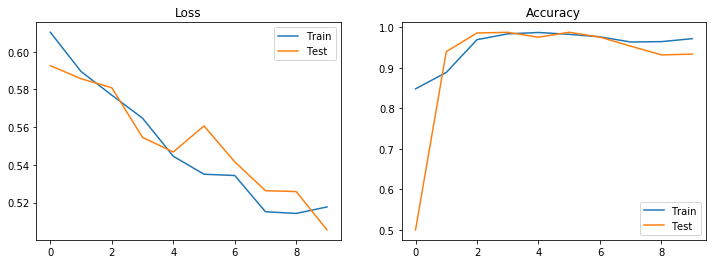

In [14]:
# check src code
from musicrl import mel_lstm

# model = mel_lstm.get_model()
history = model.fit_generator(train_generator(), validation_data=test_generator(),
                              steps_per_epoch=1, epochs=10, validation_steps=1, validation_freq=1)
mel_lstm.plot_history(history)


In [ ]:
# test data generator
from musicrl.data import RandomMidiDataGenerator
from musicrl import mel_lstm

model = mel_lstm.get_model()

train_generator = RandomMidiDataGenerator(real_midis[::2], mel_lstm.preprocess, mapper, 4, "Train")
test_generator = RandomMidiDataGenerator(real_midis[1::2], mel_lstm.preprocess, mapper, 4, "Test")

history = model.fit_generator(train_generator(), validation_data=test_generator(),
                              steps_per_epoch=1, epochs=10, validation_steps=1, validation_freq=1, verbose=1)
mel_lstm.plot_history(history)


#### Refactored version from source code

Tensor("lstm_3_input:0", shape=(None, None, 128), dtype=float32)
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_3 (LSTM)                (None, None, 128)         131584    
_________________________________________________________________
time_distributed_6 (TimeDist (None, None, 128)         16512     
_________________________________________________________________
time_distributed_7 (TimeDist (None, None, 1)           129       
Total params: 148,225
Trainable params: 148,225
Non-trainable params: 0
_________________________________________________________________
Train on 2 samples, validate on 2 samples
Epoch 1/30
2/2 [==============================] - 7s 3s/sample - loss: 0.7095 - binary_accuracy: 0.5000 - val_loss: 0.6781 - val_binary_accuracy: 0.5433
Epoch 2/30
2/2 [==============================] - 6s 3s/sample - loss: 0.6570 - binary_accuracy: 0.7005 - val_loss: 0.

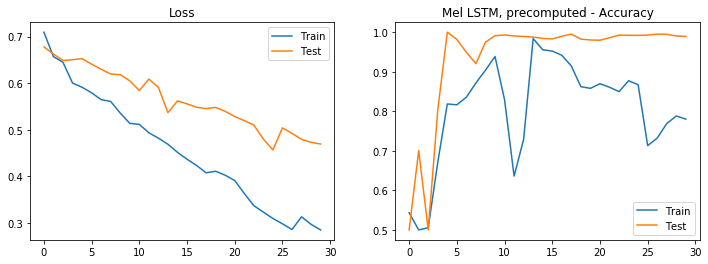

In [17]:
from musicrl import mel_lstm

model = mel_lstm.get_model()
train_generator = RandomMidiDataGenerator(real_midis[:50], mel_lstm.preprocess, mapper, 2, 8000)
test_generator = RandomMidiDataGenerator(real_midis[50:60], mel_lstm.preprocess, mapper, 2, 8000)
x_train, y_train = train_generator.compute_batch()
test_data = test_generator.compute_batch()

print(model.input)
model.summary()

history = model.fit(x_train, y_train, 8, validation_data=test_data, epochs=30, validation_freq=1, verbose=1)
seq_lstm.plot_history(history)
plt.title("Mel LSTM, precomputed - Accuracy")
plt.show()

model.save("models/mel_lstm.h5")
loaded = load_model("models/seq_lstm.h5")

Tensor("lstm_4_input:0", shape=(None, None, 128), dtype=float32)
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_4 (LSTM)                (None, None, 128)         131584    
_________________________________________________________________
time_distributed_8 (TimeDist (None, None, 128)         16512     
_________________________________________________________________
time_distributed_9 (TimeDist (None, None, 1)           129       
Total params: 148,225
Trainable params: 148,225
Non-trainable params: 0
_________________________________________________________________
Train on 2 samples, validate on 2 samples
Epoch 1/15
2/2 [==============================] - 7s 3s/sample - loss: 0.6750 - binary_accuracy: 0.5640 - val_loss: 0.6596 - val_binary_accuracy: 0.5006
Epoch 2/15
2/2 [==============================] - 6s 3s/sample - loss: 0.6629 - binary_accuracy: 0.5047 - val_loss: 0.

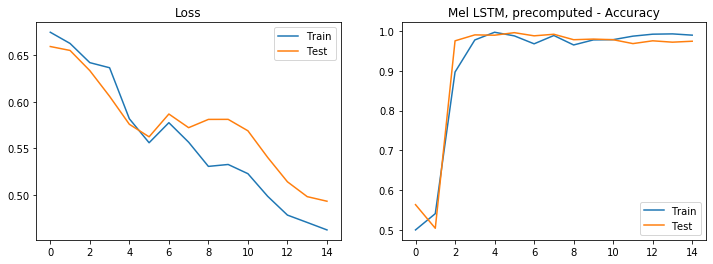

In [18]:
model = mel_lstm.get_model()
train_generator = RandomMidiDataGenerator(real_midis[:50], mel_lstm.preprocess, mapper, 2, 8000)
test_generator = RandomMidiDataGenerator(real_midis[50:60], mel_lstm.preprocess, mapper, 2, 8000)
x_train, y_train = train_generator.compute_batch()
test_data = test_generator.compute_batch()

print(model.input)
model.summary()

history = model.fit(x_train, y_train, 8, validation_data=test_data, epochs=15, validation_freq=1, verbose=1)
seq_lstm.plot_history(history)
plt.title("Mel LSTM, precomputed - Accuracy")
plt.show()

model.save("models/mel_lstm.h5")
loaded = load_model("models/seq_lstm.h5")

### LSTM on own vector representation

So this LSTM takes forever to train.

Tensor("lstm_1_input:0", shape=(None, None, 9), dtype=float32)
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, None, 128)         70656     
_________________________________________________________________
time_distributed_2 (TimeDist (None, None, 128)         16512     
_________________________________________________________________
time_distributed_3 (TimeDist (None, None, 1)           129       
Total params: 87,297
Trainable params: 87,297
Non-trainable params: 0
_________________________________________________________________
Train on 2 samples, validate on 2 samples
Epoch 1/30
2/2 [==============================] - 8s 4s/sample - loss: 0.7539 - binary_accuracy: 0.5000 - val_loss: 0.7232 - val_binary_accuracy: 0.5000
Epoch 2/30
2/2 [==============================] - 6s 3s/sample - loss: 0.7173 - binary_accuracy: 0.5000 - val_loss: 0.7022

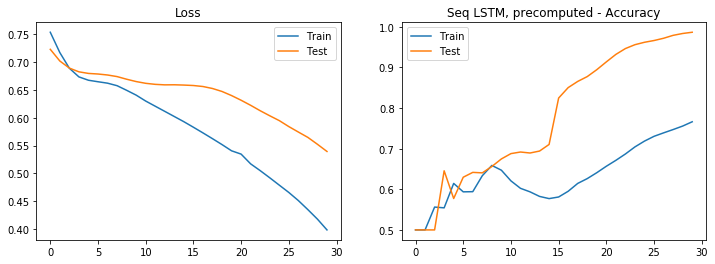

In [10]:
from musicrl import seq_lstm

model = seq_lstm.get_model(mapper.dims)
train_generator = RandomMidiDataGenerator(real_midis[:50], seq_lstm.make_preprocessor(mapper), mapper, 2, 8000)
test_generator = RandomMidiDataGenerator(real_midis[50:60], seq_lstm.make_preprocessor(mapper), mapper, 2, 8000)
x_train, y_train = train_generator.compute_batch()
test_data = test_generator.compute_batch()

print(model.input)
model.summary()

history = model.fit(x_train, y_train, 8, validation_data=test_data, epochs=30, validation_freq=1, verbose=1)
seq_lstm.plot_history(history)
plt.title("Seq LSTM, precomputed - Accuracy")
plt.show()

model.save("models/seq_lstm.h5")
loaded = load_model("models/seq_lstm.h5")

### Comparison of preprocessing

The time the models take for 30 epochs on a train set of size 50 is roughly the same, a bit over 3 minutes. The seq-lstm has a good final validation accuracy, but the test accuracy is really bad and the test loss didn't really go down. The Mel-LSTM did have a good validation accuracy after 15 epochs and then started to overfit, but both train and test loss go down and both train and test accuracy reach okayish levels, so this is the winner

### Visualizing predictions over timeframes